In [1]:
import sys
import pandas as pd
import ast
import requests
import math
import re
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from IPython.display import display
import matplotlib.image as mpimg
from PIL import Image
from sklearn.linear_model import Ridge
import seaborn as sns
import os
import time
from tqdm import tqdm
from __future__ import annotations
from pathlib import Path
from typing import List, Union
import camelot
import altair as alt
import base64

In [2]:
from euroleague_api.boxscore_data import BoxScoreData
from euroleague_api.game_stats import GameStats
from euroleague_api.play_by_play_data import PlayByPlay
from euroleague_api.player_stats import PlayerStats
from euroleague_api.shot_data import ShotData
from euroleague_api.standings import Standings
from euroleague_api.team_stats import TeamStats
from euroleague_api.game_metadata import GameMetadata

/home/chrispetr/personal_projects/euroleague_api_notebooks/.venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [27]:
def load_games_metadata(
    season: int,
    competition_code: str = "E",
    cols_to_keep=None,
):
    """
    Load EuroLeague season metadata using your API wrappers
    (TeamStats, GameMetadata) and return a cleaned `games_meta` DataFrame.

    Parameters
    ----------
    season : int
        Start year of the season (e.g., 2025 for 2025–26).
    competition_code : str
        "E" for EuroLeague, "U" for EuroCup, etc.
    cols_to_keep : list or None
        Columns to keep from the metadata API. If None, uses your default set.

    Returns
    -------
    games_meta : pd.DataFrame
        Cleaned season metadata ready for SoS/NetRtg calculations.
    team_stats_api : TeamStats
        API helper (you need it for compute_team_net_rating).
    metadata_api : GameMetadata
        API helper (you might use it for live updates or game info).
    """

    # Default columns (your version)
    if cols_to_keep is None:
        cols_to_keep = [
            "Round",
            "date",
            "gamecode",
            "gameCode",
            "hometeam",
            "homecode",
            "homescore",
            "awayteam",
            "awaycode",
            "awayscore",
        ]

    # Initialize API helpers
    team_stats_api = TeamStats(competition_code)
    metadata_api   = GameMetadata(competition_code)

    # Load raw metadata
    games_meta = metadata_api.get_gamecodes_season(season)

    # Keep only needed columns
    missing = [c for c in cols_to_keep if c not in games_meta.columns]
    if missing:
        raise ValueError(f"Missing columns in API response: {missing}")

    games_meta = games_meta[cols_to_keep].copy()

    return games_meta, team_stats_api, metadata_api


In [4]:
def compute_team_net_rating(
    team_name: str,
    season: int,
    games_meta: pd.DataFrame,
    team_stats_api,
):
    """
    Compute season-to-date OffRtg, DefRtg, NetRtg for a single team,
    using a single possession count per team:

      - games_meta (hometeam/awayteam/scores/gameCode)
      - get_team_advanced_stats_single_game(season, gamecode)
        where df_adv: row 0 = home, row 1 = away, col 3 = team possessions.

    OFF RTG: PTS / POSS * 100
    DEF RTG: OPP_PTS / POSS * 100
    NET RTG: OFF RTG - DEF RTG
    """

    # 1. All games where this team appears
    team_games = games_meta[
        (games_meta["hometeam"] == team_name)
        | (games_meta["awayteam"] == team_name)
    ].copy()

    if team_games.empty:
        raise ValueError(f"No games found for team '{team_name}' in season {season}")

    total_pts_for = 0.0
    total_pts_against = 0.0
    total_poss = 0.0  # team possessions (used for both off/def)

    per_game_rows = []

    for _, g in team_games.iterrows():
        gamecode = int(g["gameCode"])

        hometeam = g["hometeam"]
        awayteam = g["awayteam"]
        homescore = g["homescore"]
        awayscore = g["awayscore"]

        # 2. Get advanced stats for this game
        df_adv = team_stats_api.get_team_advanced_stats_single_game(season, gamecode)
        df_adv = df_adv.reset_index(drop=True)

        if df_adv.shape[1] <= 3:
            raise ValueError(
                f"df_adv for gameCode {gamecode} has no possessions column"
            )

        # col index 3 = possessions: row 0 = home, row 1 = away
        home_poss = df_adv.iloc[0, 3]
        away_poss = df_adv.iloc[1, 3]

        # 3. Assign points & "team_poss" depending on home/away
        if team_name == hometeam:
            pts_for = homescore
            pts_against = awayscore
            team_poss = home_poss
        elif team_name == awayteam:
            pts_for = awayscore
            pts_against = homescore
            team_poss = away_poss
        else:
            # should not happen given the filter
            continue

        total_pts_for += pts_for
        total_pts_against += pts_against
        total_poss += team_poss

        if team_poss > 0:
            offrtg = 100 * pts_for / team_poss
            defrtg = 100 * pts_against / team_poss
            netrtg = offrtg - defrtg
        else:
            offrtg = defrtg = netrtg = float("nan")

        per_game_rows.append(
            {
                "gameCode": gamecode,
                "hometeam": hometeam,
                "awayteam": awayteam,
                "pts_for": pts_for,
                "pts_against": pts_against,
                "poss": team_poss,
                "OffRtg": offrtg,
                "DefRtg": defrtg,
                "NetRtg": netrtg,
            }
        )

    if total_poss == 0:
        raise ValueError(f"Total possessions is zero for team '{team_name}'")

    # 4. Season-level ratings using totals
    season_offrtg = 100 * total_pts_for / total_poss
    season_defrtg = 100 * total_pts_against / total_poss
    season_netrtg = season_offrtg - season_defrtg

    per_game_df = pd.DataFrame(per_game_rows)

    return {
        "team": team_name,
        "season": season,
        "OffRtg": season_offrtg,
        "DefRtg": season_defrtg,
        "NetRtg": season_netrtg,
        "games_played": len(per_game_df),
        "per_game": per_game_df,
        "total_pts_for": total_pts_for,
        "total_pts_against": total_pts_against,
        "total_poss": total_poss,
    }


In [21]:
def compute_sos_from_netrtg_up_to_round(
    games_meta: pd.DataFrame,
    season: int,
    team_stats_api,
    round_max: int,
    *,
    round_only_played: bool = True,
    round_col: str = "Round",
) -> tuple[pd.DataFrame, pd.DataFrame]:
    """
    Compute NetRtg-based Strength of Schedule (SoS_Net) *up to and including
    a given round*.

    Steps:
      1) Filter games_meta to rounds <= round_max (optionally only played games).
      2) Compute season-to-date OffRtg/DefRtg/NetRtg for ALL teams
         using compute_team_net_rating(...) on the filtered games.
      3) Build schedule_long (TEAM_NAME, OPP_NAME, gameCode) from the same subset.
      4) Attach opponent NetRtg, compute:
           - ONR  = mean OppNetRtg
           - OONR = mean OppONR
           - SoS_Net = 0.667 * ONR + 0.334 * OONR
      5) Return (team_ratings, sos_net) for that round.

    Returns
    -------
    team_ratings : DataFrame
        Columns ['TEAM_NAME', 'Games', 'OffRtg', 'DefRtg', 'NetRtg', ...]
        computed using games up to round_max.

    sos_net : DataFrame
        Columns ['TEAM_NAME', 'Games', 'NetRtg', 'ONR', 'OONR', 'SoS_Net'],
        sorted by SoS_Net descending.
    """

    # --- 1) Filter to rounds <= round_max ---
    df = games_meta.copy()
    df = df[df[round_col] <= round_max].copy()

    if round_only_played:
        df = df[
            df["homescore"].notna() &
            df["awayscore"].notna()
        ].copy()

    # --- 2) Compute team ratings up to this round ---
    teams = sorted(set(df["hometeam"]).union(df["awayteam"]))

    team_rows = []
    for t in teams:
        res = compute_team_net_rating(
            team_name=t,
            season=season,
            games_meta=df,          # IMPORTANT: filtered df, not full games_meta
            team_stats_api=team_stats_api,
        )
        team_rows.append(res)

    team_ratings = pd.DataFrame(team_rows).rename(columns={
        "team": "TEAM_NAME",
        "games_played": "Games",
    })

    # --- 3) Long schedule: one row per (team, opponent, game) ---
    home_side = df[["gameCode", "hometeam", "awayteam"]].rename(
        columns={"hometeam": "TEAM_NAME", "awayteam": "OPP_NAME"}
    )
    away_side = df[["gameCode", "hometeam", "awayteam"]].rename(
        columns={"awayteam": "TEAM_NAME", "hometeam": "OPP_NAME"}
    )

    schedule_long = pd.concat([home_side, away_side], ignore_index=True)
    schedule_long = schedule_long.sort_values(["TEAM_NAME", "gameCode"]).reset_index(drop=True)

    # --- 4) Attach OppNetRtg and compute ONR/OONR ---
    schedule_long = schedule_long.merge(
        team_ratings[["TEAM_NAME", "NetRtg"]].rename(
            columns={"TEAM_NAME": "OPP_NAME", "NetRtg": "OppNetRtg"}
        ),
        on="OPP_NAME",
        how="left",
    )

    # ONR: mean OppNetRtg
    ONR = (
        schedule_long.groupby("TEAM_NAME")["OppNetRtg"]
        .mean()
        .reset_index()
        .rename(columns={"OppNetRtg": "ONR"})
    )
    onr_map = dict(zip(ONR["TEAM_NAME"], ONR["ONR"]))

    # OppONR: ONR of opponents
    schedule_long["OppONR"] = schedule_long["OPP_NAME"].map(onr_map)

    # OONR: mean OppONR
    OONR = (
        schedule_long.groupby("TEAM_NAME")["OppONR"]
        .mean()
        .reset_index()
        .rename(columns={"OppONR": "OONR"})
    )

    # --- 5) Merge into one SoS_Net table ---
    sos_net = (
        team_ratings[["TEAM_NAME", "Games", "NetRtg"]]
        .merge(ONR, on="TEAM_NAME", how="left")
        .merge(OONR, on="TEAM_NAME", how="left")
    )

    sos_net["SoS_Net"] = 0.667 * sos_net["ONR"] + 0.334 * sos_net["OONR"]

    sos_net = sos_net.round({"NetRtg": 2, "ONR": 2, "OONR": 2, "SoS_Net": 2})
    sos_net = sos_net.sort_values("SoS_Net", ascending=False).reset_index(drop=True)

    return team_ratings, sos_net


In [24]:
def compute_sos_from_winpct_up_to_round(
    games_meta: pd.DataFrame,
    round_max: int,
    *,
    round_col: str = "Round",
    round_only_played: bool = True,
) -> pd.DataFrame:
    """
    Compute Strength of Schedule (SoS) for all teams *up to and including
    a given round*, using the Hack-a-Stat Win%-based definition:

      - OW%  = average opponent Win% (each opponent counted once per game),
               where opponent Win% is computed EXCLUDING games vs the team
               under analysis.
      - OOW% = average OW% of the opponents faced (again, counting by games).
      - SoS  = (2 * OW% + OOW%) / 3

    Parameters
    ----------
    games_meta : pd.DataFrame
        Must contain columns:
        ['Round', 'hometeam', 'awayteam', 'homescore', 'awayscore'].
        Only rows where both scores are non-null are treated as played games
        if round_only_played=True.

    round_max : int
        Last round to include (all games with Round <= round_max).

    round_col : str, optional
        Name of the round column (default: "Round").

    round_only_played : bool, optional
        If True, filter to games where both scores are non-null.

    Returns
    -------
    sos_df : pd.DataFrame
        Columns:
        ['TEAM_NAME', 'TmGP', 'OW%', 'OOW%', 'SoS']
        representing SoS based on **games up to round_max**.
    """

    # --- 0) Filter by round, optionally only completed games ---
    df = games_meta.copy()
    df = df[df[round_col] <= round_max].copy()

    if round_only_played:
        df = df[
            df["homescore"].notna() &
            df["awayscore"].notna()
        ].reset_index(drop=True)

    # All teams in the dataset (after filtering)
    teams = sorted(set(df["hometeam"]).union(df["awayteam"]))

    # ------------------------------------------------------------------
    # Helper: team W% (optionally excluding games vs a specific opponent)
    # ------------------------------------------------------------------
    def team_win_pct_excluding(team: str, exclude_opponent: str | None = None) -> float:
        g = df[(df["hometeam"] == team) | (df["awayteam"] == team)].copy()
        if exclude_opponent is not None:
            mask_vs_excl = (
                ((g["hometeam"] == team) & (g["awayteam"] == exclude_opponent)) |
                ((g["awayteam"] == team) & (g["hometeam"] == exclude_opponent))
            )
            g = g[~mask_vs_excl]

        if g.empty:
            return np.nan  # no info; will be ignored in later averages

        wins = (
            ((g["hometeam"] == team) & (g["homescore"] > g["awayscore"])) |
            ((g["awayteam"] == team) & (g["awayscore"] > g["homescore"]))
        ).sum()

        gp = len(g)
        return wins / gp

    # ------------------------------------------------------------------
    # Build opponents-by-team (each game => one opponent for each team)
    # ------------------------------------------------------------------
    opponents_by_team = {t: [] for t in teams}

    for _, row in df.iterrows():
        h = row["hometeam"]
        a = row["awayteam"]
        opponents_by_team[h].append(a)
        opponents_by_team[a].append(h)

    # TmGP = games played (just length of the list)
    tm_games_played = {t: len(opponents_by_team[t]) for t in teams}

    # ------------------------------------------------------------------
    # 1) Compute OW% for every team
    # ------------------------------------------------------------------
    OW = {}

    for team in teams:
        opps = opponents_by_team[team]
        if not opps:
            OW[team] = np.nan
            continue

        opp_w_list = []
        for opp in opps:
            opp_w_excl_team = team_win_pct_excluding(opp, exclude_opponent=team)
            if not np.isnan(opp_w_excl_team):
                opp_w_list.append(opp_w_excl_team)

        OW[team] = float(np.mean(opp_w_list)) if opp_w_list else np.nan

    # ------------------------------------------------------------------
    # 2) Compute OOW% for every team:
    #    average of OW% of the opponents they faced (per game).
    # ------------------------------------------------------------------
    OOW = {}

    for team in teams:
        opps = opponents_by_team[team]
        if not opps:
            OOW[team] = np.nan
            continue

        opp_ow_list = []
        for opp in opps:
            opp_ow = OW.get(opp, np.nan)
            if not np.isnan(opp_ow):
                opp_ow_list.append(opp_ow)

        OOW[team] = float(np.mean(opp_ow_list)) if opp_ow_list else np.nan

    # ------------------------------------------------------------------
    # 3) SoS = (2 * OW% + OOW%) / 3
    # ------------------------------------------------------------------
    data = []
    for t in teams:
        tmgp = tm_games_played[t]
        ow   = OW[t]
        oow  = OOW[t]
        sos  = (2 * ow + oow) / 3 if not (np.isnan(ow) or np.isnan(oow)) else np.nan
        data.append({
            "TEAM_NAME": t,
            "TmGP": tmgp,
            "OW%": ow,
            "OOW%": oow,
            "SoS": sos,
        })

    sos_df = pd.DataFrame(data)

    # Sort from toughest to easiest schedule (highest SoS first)
    sos_df = sos_df.sort_values("SoS", ascending=False).reset_index(drop=True)
    return sos_df

Get 5 Next matches SoS

In [12]:
# 1) Map TEAM_NAME -> logo filename
team_logo_file = {
    "ANADOLU EFES ISTANBUL": "Anadolu Efes_logo.png",
    "KOSNER BASKONIA VITORIA-GASTEIZ": "Baskonia_logo.png",
    "BASKONIA VITORIA-GASTEIZ": "Baskonia_logo.png",
    "CRVENA ZVEZDA MERIDIANBET BELGRADE": "Crvena Zvezda_logo.png",
    "DUBAI BASKETBALL": "Dubai_logo.png",
    "HAPOEL IBI TEL AVIV": "Hapoel Tel Aviv_logo.png",
    "PANATHINAIKOS AKTOR ATHENS": "Panathinaikos_logo.png",
    "VIRTUS BOLOGNA": "Virtus_logo.png",
    "FENERBAHCE BEKO ISTANBUL": "Fenerbahce_logo.png",
    "AS MONACO": "Monaco_logo.png",
    "LDLC ASVEL VILLEURBANNE": "ASVEL_logo.png",
    "MACCABI RAPYD TEL AVIV": "Maccabi_logo.png",
    "MACCABI TEL AVIV": "Maccabi_logo.png",
    "OLYMPIACOS PIRAEUS": "Olympiacos_logo.png",
    "EA7 EMPORIO ARMANI MILAN": "Milan_logo.png",
    "PARTIZAN MOZZART BET BELGRADE": "Partizan_logo.png",
    "FC BARCELONA": "Barcelona_logo.png",
    "FC BAYERN MUNICH": "Bayern_logo.png",
    "REAL MADRID": "Real_logo.png",
    "PARIS BASKETBALL": "Paris_logo.png",
    "ZALGIRIS KAUNAS": "Zalgiris_logo.png",
    "VALENCIA BASKET": "Valencia_logo.png",
}

logos_dir = "team_logos"

def team_to_logo_path(team_name: str):
    fname = team_logo_file.get(team_name)
    if fname is None:
        return None
    path = os.path.join(logos_dir, fname)
    return path if os.path.exists(path) else None

In [13]:
TEAM_NAME_MAP = {
    "MACCABI RAPYD TEL AVIV": "MACCABI TEL AVIV",
    "KOSNER BASKONIA VITORIA-GASTEIZ": "BASKONIA VITORIA-GASTEIZ",
}

def normalize_team_name(name: str) -> str:
    if pd.isna(name):
        return name
    name = name.strip().upper()
    return TEAM_NAME_MAP.get(name, name)


def load_clean_schedule(csv_path: str | Path) -> pd.DataFrame:
    """
    Load the saved 2025–26 schedule and get it ready for next-N-games logic.

    Expected columns in CSV:
        Round, Date, Local_Time, GMT_Time, Home_Team, Away_Team

    Returns
    -------
    DataFrame with a parsed DateTime column and sorted by Round, DateTime.
    """
    df = pd.read_csv(csv_path)

    # Normalize NA-ish values
    df = df.replace({"<NA>": pd.NA, "nan": pd.NA, "None": pd.NA})

    core_cols = ["Round", "Date", "Local_Time", "Home_Team", "Away_Team"]
    for c in core_cols:
        if c in df.columns:
            df[c] = df[c].astype(str).str.strip()
            df.loc[df[c].isin(["", "nan", "None", "<NA>"]), c] = pd.NA

    # Drop rows that don't look like real games
    df = df.dropna(subset=["Round", "Home_Team", "Away_Team", "Local_Time"])

    # Round may be "1.0", "2.0", ...
    df["Round"] = pd.to_numeric(df["Round"], errors="coerce")
    df["Round"] = df["Round"].round().astype("Int64")

    # Parse local tipoff datetime: "Tuesday, 30 September 2025 20:00"
    df["DateTime"] = pd.to_datetime(
        df["Date"] + " " + df["Local_Time"],
        errors="coerce"
    )

    # Sort for deterministic behavior
    df = df.sort_values(["Round", "DateTime"]).reset_index(drop=True)
    df["Home_Team"] = df["Home_Team"].apply(normalize_team_name)
    df["Away_Team"] = df["Away_Team"].apply(normalize_team_name)

    return df

def build_next_n_games_per_team(
    games: pd.DataFrame,
    current_round: int,
    n_next: int = 5,
) -> dict[str, pd.DataFrame]:
    """
    For each team, get the next `n_next` games starting from `current_round`
    (inclusive), sorted by Round then DateTime.

    Returns
    -------
    dict(team_name -> DataFrame)
        Each DataFrame has columns: ["Round", "DateTime", "Is_Home", "Opponent"]
    """
    df = games.copy()

    teams = sorted(set(df["Home_Team"]) | set(df["Away_Team"]))
    team_to_next: dict[str, pd.DataFrame] = {}

    for team in teams:
        mask_team = (df["Home_Team"] == team) | (df["Away_Team"] == team)
        team_games = df[mask_team].copy()

        # Only games from current_round onward
        upcoming = team_games[team_games["Round"] >= current_round].copy()
        upcoming = upcoming.sort_values(["Round", "DateTime"])

        if upcoming.empty:
            team_to_next[team] = pd.DataFrame(
                columns=["Round", "DateTime", "Is_Home", "Opponent"]
            )
            continue

        upcoming = upcoming.head(n_next).copy()

        def get_opponent(row):
            return row["Away_Team"] if row["Home_Team"] == team else row["Home_Team"]

        def is_home(row):
            return row["Home_Team"] == team

        upcoming["Opponent"] = upcoming.apply(get_opponent, axis=1)
        upcoming["Is_Home"] = upcoming.apply(is_home, axis=1)

        team_to_next[team] = upcoming[["Round", "DateTime", "Is_Home", "Opponent"]].reset_index(drop=True)

    return team_to_next

def compute_sos_net_rating_next5(
    team_to_next_games: dict[str, pd.DataFrame],
    team_ratings: pd.DataFrame,
) -> dict[str, float]:
    """
    SoS_Net_next5(team) = mean(NetRtg of opponents in the next N games).

    `team_ratings` must have columns: ["TEAM_NAME", "NetRtg"].
    """
    net_map = dict(zip(team_ratings["TEAM_NAME"], team_ratings["NetRtg"]))
    sos_net_next5: dict[str, float] = {}

    for team, df_next in team_to_next_games.items():
        if df_next.empty:
            sos_net_next5[team] = float("nan")
            continue

        opp_vals = []
        for _, row in df_next.iterrows():
            opp = row["Opponent"]
            if opp in net_map:
                opp_vals.append(net_map[opp])

        sos_net_next5[team] = float(sum(opp_vals) / len(opp_vals)) if opp_vals else float("nan")

    return sos_net_next5

def compute_team_win_pct(games_meta: pd.DataFrame) -> dict[str, float]:
    """
    Compute basic Win% for each team from games_meta.

    games_meta must contain:
        ['hometeam', 'awayteam', 'homescore', 'awayscore'].
    """
    df = games_meta.copy()
    df = df[
        df["homescore"].notna() &
        df["awayscore"].notna()
    ].reset_index(drop=True)

    teams = sorted(set(df["hometeam"]).union(df["awayteam"]))
    win_pct: dict[str, float] = {}

    for team in teams:
        g = df[(df["hometeam"] == team) | (df["awayteam"] == team)].copy()
        if g.empty:
            win_pct[team] = np.nan
            continue

        wins = (
            ((g["hometeam"] == team) & (g["homescore"] > g["awayscore"])) |
            ((g["awayteam"] == team) & (g["awayscore"] > g["homescore"]))
        ).sum()

        gp = len(g)
        win_pct[team] = wins / gp if gp > 0 else np.nan

    return win_pct


def compute_sos_winpct_next5(
    team_to_next_games: dict[str, pd.DataFrame],
    team_win_pct: dict[str, float],
) -> dict[str, float]:
    """
    SoS_Win_next5(team) = mean(Win% of opponents in the next N games).

    `team_win_pct` maps "TEAM_NAME" -> Win% in [0, 1].
    """
    sos_win_next5: dict[str, float] = {}

    for team, df_next in team_to_next_games.items():
        if df_next.empty:
            sos_win_next5[team] = float("nan")
            continue

        opp_vals = []
        for _, row in df_next.iterrows():
            opp = row["Opponent"]
            if opp in team_win_pct:
                opp_vals.append(team_win_pct[opp])

        sos_win_next5[team] = float(sum(opp_vals) / len(opp_vals)) if opp_vals else float("nan")

    return sos_win_next5

In [14]:
def make_nextN_sos_table(
    current_round: int,
    schedule_path: str | Path,
    games_meta: pd.DataFrame,
    team_ratings: pd.DataFrame,
    team_to_logo_path_fn,
    n_next: int = 5,
) -> pd.DataFrame:
    """
    Compute Strength of Schedule for the next N games per team (no plotting).

    Uses your existing helpers:
      - normalize_team_name
      - load_clean_schedule
      - build_next_n_games_per_team
      - compute_sos_net_rating_next5  (works for any N)
      - compute_team_win_pct
      - compute_sos_winpct_next5

    Returns a DataFrame with columns:
      - Team
      - SoS_Net_nextN
      - SoS_Win_nextN
      - Logo_Path
      - Opp1 ... OppN
      - Opponents   (comma-separated string of up to N opponents)
    """

    # 1) Normalize names in games_meta & team_ratings
    games_meta = games_meta.copy()
    games_meta["hometeam"] = games_meta["hometeam"].apply(normalize_team_name)
    games_meta["awayteam"] = games_meta["awayteam"].apply(normalize_team_name)

    team_ratings = team_ratings.copy()
    team_ratings["TEAM_NAME"] = team_ratings["TEAM_NAME"].apply(normalize_team_name)

    # 2) Load cleaned schedule
    games_sched = load_clean_schedule(schedule_path)

    # 3) Build next N games per team from current_round
    team_to_next_games = build_next_n_games_per_team(
        games=games_sched,
        current_round=current_round,
        n_next=n_next,
    )

    # 4) SoS based on Net Rating (uses next N games)
    sos_net_nextN = compute_sos_net_rating_next5(
        team_to_next_games=team_to_next_games,
        team_ratings=team_ratings,
    )

    # 5) Win% per team (full season)
    team_win_pct = compute_team_win_pct(games_meta)

    # 6) SoS based on Win% (uses next N games)
    sos_win_nextN = compute_sos_winpct_next5(
        team_to_next_games=team_to_next_games,
        team_win_pct=team_win_pct,
    )

    # 7) Build final table with up to N opponents in wide form
    teams = sorted(team_to_next_games.keys())
    rows = []

    for team in teams:
        next_df = team_to_next_games.get(team, pd.DataFrame())

        opps: list[str] = []
        if not next_df.empty and "Opponent" in next_df.columns:
            opps = (
                next_df["Opponent"]
                .astype(str)
                .fillna("")
                .tolist()
            )

        # keep at most N opponents
        opps = [o for o in opps if o][:n_next]

        # pad to length N so we always have Opp1..OppN columns
        while len(opps) < n_next:
            opps.append(None)

        row = {
            "Team": team,
            "SoS_Net_nextN": sos_net_nextN.get(team, float("nan")),
            "SoS_Win_nextN": sos_win_nextN.get(team, float("nan")),
            "Logo_Path": team_to_logo_path_fn(team),
            "Opponents": ", ".join([o for o in opps if o]),
        }

        # Opp1..OppN columns
        for idx in range(1, n_next + 1):
            row[f"Opp{idx}"] = opps[idx - 1]

        rows.append(row)

    sos_nextN_df = pd.DataFrame(rows)

    # sort by toughest schedule (highest SoS_Net_nextN) at the top
    sos_nextN_df = sos_nextN_df.sort_values(
        "SoS_Net_nextN", ascending=False
    ).reset_index(drop=True)

    return sos_nextN_df


In [15]:
def logo_to_dataurl(path: str | None) -> str | None:
    """Convert a local image file to a data URL for embedding in Altair exports."""
    if not path or not isinstance(path, str):
        return None
    if not os.path.exists(path):
        return None
    with open(path, "rb") as f:
        data = f.read()
    b64 = base64.b64encode(data).decode("utf-8")
    # Use generic PNG MIME; works fine for most logos
    return f"data:image/png;base64,{b64}"


def build_nextN_altair_logos_table(
    nextN_df: pd.DataFrame,
    team_ratings: pd.DataFrame,
    team_to_logo_path_fn,
    round_ref: int,
    n_next: int,
):
    """
    Build a table-like Altair chart for the next N games:

    - Left column: team logo + team name
    - Middle column: SoS_Net_nextN (color = green→white→red, text = value)
    - Right block: next N opponents
        * cell color = Opp_NetRtg (continuous green→white→red, 0 neutral)
        * inside each cell: opponent logo only

    Expects nextN_df from make_nextN_sos_table, with columns:
      - Team
      - SoS_Net_nextN
      - Logo_Path   (optional, not strictly required here)
      - Opp1..OppN
    """

    # ---------- STYLE SETTINGS ----------
    ROW_FONT = "Inter"
    TITLE_FONT = "Montserrat"

    FONT_SIZE = 15
    TITLE_FONT_SIZE = 22

    LEFT_COL_WIDTH = 260
    SOS_COL_WIDTH = 120
    GAMES_COL_WIDTH = 340

    LOGO_SIZE_MAIN = 24
    LOGO_SIZE_OPP = 26

    # ---------- 1) Map team -> NetRtg (for opponent strength) ----------
    ratings = team_ratings.copy()
    ratings["TEAM_NAME"] = ratings["TEAM_NAME"].apply(normalize_team_name)
    net_map = dict(zip(ratings["TEAM_NAME"], ratings["NetRtg"]))

    # ---------- 2) Wide -> long for the N opponents ----------
    long_rows = []
    for _, row in nextN_df.iterrows():
        team_display = row["Team"]
        team_norm = normalize_team_name(team_display)

        # SoS value: prefer SoS_Net_nextN, fallback to legacy SoS_Net_next5 if present
        sos_net = row.get("SoS_Net_nextN", row.get("SoS_Net_next5", np.nan))

        # Team logo
        team_logo_path = team_to_logo_path_fn(team_norm)
        team_logo_dataurl = logo_to_dataurl(team_logo_path)

        for idx in range(1, n_next + 1):
            col = f"Opp{idx}"
            if col not in row:
                continue
            opp = row[col]
            if pd.isna(opp) or opp is None or opp == "":
                continue

            opp_norm = normalize_team_name(opp)
            opp_netrtg = net_map.get(opp_norm, np.nan)

            opp_logo_path = team_to_logo_path_fn(opp_norm)
            opp_logo_dataurl = logo_to_dataurl(opp_logo_path)

            long_rows.append(
                {
                    "Team": team_norm,
                    "Team_Display": team_display,
                    "Team_Logo_DataURL": team_logo_dataurl,
                    "SoS_Net_nextN": sos_net,
                    "game_idx": idx,
                    "Opponent": opp_norm,
                    "Opp_NetRtg": opp_netrtg,
                    "Opp_Logo_DataURL": opp_logo_dataurl,
                }
            )

    alt_df = pd.DataFrame(long_rows)
    if alt_df.empty:
        raise ValueError("No opponent data found in nextN_df for Altair chart.")

    # ---------- 3) One row per team for left + SoS ----------
    teams_df = (
        alt_df[["Team", "Team_Display", "Team_Logo_DataURL", "SoS_Net_nextN"]]
        .drop_duplicates(subset=["Team"])
        .reset_index(drop=True)
    )

    # Sort by SoS hardest → easiest
    team_order = (
        teams_df.sort_values("SoS_Net_nextN", ascending=False)["Team"].tolist()
    )

    teams_df["SoS_Col"] = "SoS"

    # ---------- 4) Left column: logo + team name ----------
    logo_mark = (
        alt.Chart(teams_df)
        .mark_image(width=LOGO_SIZE_MAIN, height=LOGO_SIZE_MAIN)
        .encode(
            x=alt.value(0),
            y=alt.Y("Team:N", sort=team_order, title=None, axis=None),
            url="Team_Logo_DataURL:N",
            tooltip=[alt.Tooltip("Team_Display:N", title="Team")],
        )
        .properties(width=LEFT_COL_WIDTH)
    )

    team_text = (
        alt.Chart(teams_df)
        .mark_text(
            align="left",
            baseline="middle",
            dx=LOGO_SIZE_MAIN + 10,
            size=FONT_SIZE,
        )
        .encode(
            x=alt.value(0),
            y=alt.Y("Team:N", sort=team_order, title=None, axis=None),
            text="Team_Display:N",
        )
    )

    left_col = logo_mark + team_text

    # ---------- 5) SoS column ----------
    sos_color = alt.Color(
        "SoS_Net_nextN:Q",
        title="SoS (NetRtg)",
        scale=alt.Scale(
            domainMid=0.0,
            range=["green", "white", "red"],  # easy → neutral → hard
        ),
        legend=None,
    )

    sos_rect = (
        alt.Chart(teams_df)
        .mark_rect(stroke="lightgray")
        .encode(
            x=alt.X("SoS_Col:N", title=f"Next-{n_next} SoS"),
            y=alt.Y("Team:N", sort=team_order, title=None, axis=None),
            color=sos_color,
            tooltip=[
                alt.Tooltip("Team_Display:N", title="Team"),
                alt.Tooltip("SoS_Net_nextN:Q", title="SoS (NetRtg)", format=".2f"),
            ],
        )
        .properties(width=SOS_COL_WIDTH)
    )

    sos_text = (
        alt.Chart(teams_df)
        .mark_text(size=FONT_SIZE, baseline="middle")
        .encode(
            x=alt.X("SoS_Col:N", title=f"Next-{n_next} SoS"),
            y=alt.Y("Team:N", sort=team_order, title=None, axis=None),
            text=alt.Text("SoS_Net_nextN:Q", format=".2f"),
        )
    )

    sos_col = sos_rect + sos_text

    # ---------- 6) Next-N games block ----------
    opp_color = alt.Color(
        "Opp_NetRtg:Q",
        title="Opp NetRtg",
        scale=alt.Scale(domainMid=0.0, range=["green", "white", "red"]),
        legend=None,
    )

    games_rect = (
        alt.Chart(alt_df)
        .mark_rect(stroke="lightgray")
        .encode(
            x=alt.X(
                "game_idx:O",
                title=f"Next {n_next} games",
                axis=alt.Axis(labelAngle=0),
            ),
            y=alt.Y("Team:N", sort=team_order, title=None, axis=None),
            color=opp_color,
            tooltip=[
                alt.Tooltip("Team_Display:N", title="Team"),
                alt.Tooltip("game_idx:O", title="#"),
                alt.Tooltip("Opponent:N", title="Opponent"),
                alt.Tooltip("Opp_NetRtg:Q", title="Opp NetRtg", format=".2f"),
                alt.Tooltip("SoS_Net_nextN:Q", title="Team SoS", format=".2f"),
            ],
        )
        .properties(width=GAMES_COL_WIDTH)
    )

    games_logos = (
        alt.Chart(alt_df)
        .mark_image(width=LOGO_SIZE_OPP, height=LOGO_SIZE_OPP)
        .encode(
            x=alt.X("game_idx:O"),
            y=alt.Y("Team:N", sort=team_order, title=None, axis=None),
            url="Opp_Logo_DataURL:N",
        )
    )

    games_block = games_rect + games_logos

    # ---------- 7) Final layout + title + fonts ----------
    title_txt = (
        f"Euroleague Strength of Schedule based on NetRtg "
        f"from round {round_ref - 1} for the next {n_next} games"
    )

    chart = (
        alt.hconcat(
            left_col,
            sos_col,
            games_block,
            spacing=25,
        )
        .resolve_scale(y="shared")
        .properties(
            title=alt.TitleParams(
                title_txt,
                font=TITLE_FONT,
                fontSize=TITLE_FONT_SIZE,
                anchor="start",
            ),
            padding={"left": 20, "right": 20, "top": 20, "bottom": 20},
        )
        .configure_axis(
            labelFont=ROW_FONT,
            titleFont=ROW_FONT,
            labelFontSize=FONT_SIZE,
            titleFontSize=FONT_SIZE,
        )
        .configure_title(
            font=TITLE_FONT,
            fontSize=TITLE_FONT_SIZE,
        )
        .configure_text(
            font=ROW_FONT,
            fontSize=FONT_SIZE,
        )
        .configure_view(
            stroke=None
        )
        .configure_legend(
            labelFont=ROW_FONT,
            titleFont=ROW_FONT,
            labelFontSize=FONT_SIZE,
            titleFontSize=FONT_SIZE,
        )
    )

    return chart

Plot Strength of Schedule through NetRtg and Opponent Win%

In [16]:
def make_sos_table_chart(
    sos_net: pd.DataFrame,
    sos_win: pd.DataFrame,
    team_to_logo_path,
    logo_to_dataurl,
    *,
    round_ref: int | None = None,
    season_label: str | None = None,
    title: str | None = None,
    logo_size: int = 28,
    padding_inner: float = 0.35,
    padding_outer: float = 0.10,
    row_height: int = 28,
) -> alt.Chart:
    """
    Build the SoS table (logos + SoS_Net bar + SoS_win bar) as an Altair chart.

    sos_net: must have ['TEAM_NAME', 'SoS_Net']
    sos_win: must have ['TEAM_NAME', 'SoS'] (SoS = Win% SoS)
    """

    # ---------- dynamic title ----------
    if title is None:
        if season_label is not None and round_ref is not None:
            title = (
                f"EuroLeague Strength of Schedule {season_label} "
                f"(After Round {round_ref - 1})\n(Net Rating vs Win% Methods)"
            )
        elif round_ref is not None:
            title = (
                f"EuroLeague Strength of Schedule (After Round {round_ref - 1})\n"
                f"(Net Rating vs Win% Methods)"
            )
        else:
            title = "EuroLeague Strength of Schedule\n(Net Rating vs Win% Methods)"

    # --- build combined dataframe (same as before) ---
    df_net = sos_net[["TEAM_NAME", "SoS_Net"]].copy()
    df_win = sos_win[["TEAM_NAME", "SoS"]].copy().rename(columns={"SoS": "SoS_win"})

    combined = df_net.merge(df_win, on="TEAM_NAME", how="inner")
    combined = combined.sort_values("SoS_Net", ascending=False).reset_index(drop=True)

    combined["logo_path"] = combined["TEAM_NAME"].apply(team_to_logo_path)
    combined["logo_url"] = combined["logo_path"].apply(logo_to_dataurl)

    # --- normalization ---
    min_net = float(combined["SoS_Net"].min())
    max_net = float(combined["SoS_Net"].max())
    range_net = max_net - min_net if max_net != min_net else 1.0

    min_win = float(combined["SoS_win"].min())
    max_win = float(combined["SoS_win"].max())
    range_win = max_win - min_win if max_win != min_win else 1.0

    def norm_with_margin(val, vmin, vrange, margin=0.05):
        raw = (val - vmin) / vrange
        raw = max(0.0, min(1.0, raw))
        return margin + (1 - 2 * margin) * raw   # e.g. [0.05, 0.95]

    combined["SoS_Net_norm"] = combined["SoS_Net"].apply(
        lambda v: norm_with_margin(v, min_net, range_net, margin=0.05)
    )
    combined["SoS_win_norm"] = combined["SoS_win"].apply(
        lambda v: norm_with_margin(v, min_win, range_win, margin=0.05)
    )

    team_order = combined["TEAM_NAME"].tolist()

    # common y scale with padding (for spacing between rows)
    y_scale = alt.Scale(paddingInner=padding_inner, paddingOuter=padding_outer)

    # =========================================================
    # LEFT COLUMN: logo + single team name
    # =========================================================

    logo_col = alt.Chart(combined).mark_image(
        width=logo_size,
        height=logo_size,
    ).encode(
        y=alt.Y(
            "TEAM_NAME:N",
            sort=team_order,
            scale=y_scale,
            axis=None,
        ),
        x=alt.value(25),
        url="logo_url:N",
    ).properties(
        width=90,
        height=row_height * len(combined),
        title="TEAM",
    )

    name_col = alt.Chart(combined).mark_text(
        align="left",
        baseline="middle",
        dx=logo_size + 27,  # 55 for size 28; scales if you change logo_size
        fontSize=11,
    ).encode(
        y=alt.Y(
            "TEAM_NAME:N",
            sort=team_order,
            scale=y_scale,
            axis=None,
        ),
        x=alt.value(0),
        text="TEAM_NAME:N",
    )

    left_col = logo_col + name_col

    # =========================================================
    # MIDDLE COLUMN: SoS (NetRtg)
    # =========================================================

    net_bar = alt.Chart(combined).mark_bar(
        stroke="black",      # black outline
        strokeWidth=0.7,
    ).encode(
        y=alt.Y(
            "TEAM_NAME:N",
            sort=team_order,
            scale=y_scale,
            axis=None,
        ),
        x=alt.X(
            "SoS_Net_norm:Q",
            title=None,
            axis=alt.Axis(labels=False, ticks=False),
            scale=alt.Scale(domain=[0, 1]),
        ),
        color=alt.condition(
            "datum.SoS_Net < 0",
            alt.value("green"),
            alt.value("red"),
        ),
    )

    net_text = alt.Chart(combined).mark_text(
        color="black",
        fontSize=11,
        dx=2,
        align="left",
        baseline="middle",
    ).encode(
        y=alt.Y(
            "TEAM_NAME:N",
            sort=team_order,
            scale=y_scale,
            axis=None,
        ),
        x=alt.X("SoS_Net_norm:Q", scale=alt.Scale(domain=[0, 1])),
        text=alt.Text("SoS_Net:Q", format=".2f"),
    )

    net_col = (net_bar + net_text).properties(
        width=220,
        height=row_height * len(combined),
        title="SoS (NetRtg)",
    )

    # =========================================================
    # RIGHT COLUMN: SoS (Win%)
    # =========================================================

    win_bar = alt.Chart(combined).mark_bar(
        stroke="black",      # black outline
        strokeWidth=0.7,
    ).encode(
        y=alt.Y(
            "TEAM_NAME:N",
            sort=team_order,
            scale=y_scale,
            axis=None,
        ),
        x=alt.X(
            "SoS_win_norm:Q",
            title=None,
            axis=alt.Axis(labels=False, ticks=False),
            scale=alt.Scale(domain=[0, 1]),
        ),
        color=alt.condition(
            "datum.SoS_win < 0.50",
            alt.value("green"),
            alt.value("red"),
        ),
    )

    win_text = alt.Chart(combined).mark_text(
        color="black",
        fontSize=11,
        dx=2,
        align="left",
        baseline="middle",
    ).encode(
        y=alt.Y(
            "TEAM_NAME:N",
            sort=team_order,
            scale=y_scale,
            axis=None,
        ),
        x=alt.X("SoS_win_norm:Q", scale=alt.Scale(domain=[0, 1])),
        text=alt.Text("SoS_win:Q", format=".1%"),
    )

    win_col = (win_bar + win_text).properties(
        width=220,
        height=row_height * len(combined),
        title="SoS (Win%)",
    )

    # =========================================================
    # FINAL TABLE
    # =========================================================

    sos_table_chart = alt.hconcat(
        left_col,
        net_col,
        win_col,
    ).resolve_scale(
        y="shared",
    ).properties(
        title=title,
    )

    return sos_table_chart


In [17]:
def make_sos_scatter_with_table(
    sos_net: pd.DataFrame,
    team_ratings: pd.DataFrame,
    team_to_logo_path,
    logo_to_dataurl,
    *,
    top_k: int = 5,
    bottom_k: int = 5,
    round_ref: int | None = None,
    season_label: str | None = None,
    title: str | None = None,
    background: str = "#a3a1a1",
) -> alt.Chart:
    """
    Build the SoS(NetRtg) vs NetRtg scatter with quadrant labels and
    a side table showing top_k and bottom_k teams by NetRtg.

    Parameters
    ----------
    sos_net : DataFrame
        Must contain ['TEAM_NAME', 'SoS_Net'].
    team_ratings : DataFrame
        Must contain ['TEAM_NAME', 'NetRtg', 'OffRtg', 'DefRtg'].
    team_to_logo_path : callable
        Function TEAM_NAME -> local logo path.
    logo_to_dataurl : callable
        Function path -> data URL string (for Altair images).
    top_k, bottom_k : int
        Number of best / worst teams to show in the side panel.
    round_ref : int, optional
        Round number used for dynamic title ("After Round N").
    season_label : str, optional
        Season label, e.g. "2025-26".
    title : str, optional
        If provided, overrides the auto-generated title.
    background : str
        Background color for the combined chart.
    """

    # ---------- dynamic title ----------
    if title is None:
        if season_label is not None and round_ref is not None:
            title = (
                f"EuroLeague {season_label}: Strength of Schedule (NetRtg) "
                f"vs Team Net Rating (After Round {round_ref - 1})"
            )
        elif round_ref is not None:
            title = (
                f"EuroLeague: Strength of Schedule (NetRtg) "
                f"vs Team Net Rating (After Round {round_ref - 1})"
            )
        else:
            title = "EuroLeague: Strength of Schedule (NetRtg) vs Team Net Rating"

    # =========================================================
    # 0. Combine data + ranking
    # =========================================================
    df = sos_net[["TEAM_NAME", "SoS_Net"]].merge(
        team_ratings[["TEAM_NAME", "NetRtg", "OffRtg", "DefRtg"]],
        on="TEAM_NAME",
        how="inner",
    )

    df["logo_path"] = df["TEAM_NAME"].apply(team_to_logo_path)
    df["logo_url"] = df["logo_path"].apply(logo_to_dataurl)

    # Rank by NetRtg (1 = best)
    df["Rank"] = df["NetRtg"].rank(ascending=False, method="first").astype(int)
    df["Label"] = ""
    df.loc[df["Rank"] <= 4, "Label"] = "#" + df["Rank"].astype(str)
    df.loc[df["Rank"] > len(df) - 4, "Label"] = "#" + df["Rank"].astype(str)

    # for labels on logos (top-4 + bottom-4)
    hi_lo_df = df[(df["Rank"] <= 4) | (df["Rank"] > len(df) - 4)].copy()

    # =========================================================
    # 1. Axis ranges
    # =========================================================
    x_min_raw = float(df["SoS_Net"].min())
    x_max_raw = float(df["SoS_Net"].max())

    abs_max = max(abs(x_min_raw), abs(x_max_raw))
    if abs_max < 0.25:
        abs_max = 0.25

    # reversed axis → hard schedule on the LEFT
    x_domain = [abs_max, -abs_max]

    y_min = float(df["NetRtg"].min())
    y_max = float(df["NetRtg"].max())

    # =========================================================
    # 2. Quadrant labels
    # =========================================================
    x_left = abs_max * 0.65   # tough schedule side
    x_right = -abs_max * 0.65 # easy schedule side
    y_top = y_max * 0.65
    y_bottom = y_min * 0.65

    quad_df = pd.DataFrame([
        {"x": x_left,  "y": y_top,    "label": "Tough Schedule\nOverperforming",  "color": "darkorange"},
        {"x": x_right, "y": y_top,    "label": "Easy Schedule\nStrong Team",      "color": "teal"},
        {"x": x_left,  "y": y_bottom, "label": "Tough Schedule\nUnderperforming", "color": "green"},
        {"x": x_right, "y": y_bottom, "label": "Easy Schedule\nUnderperforming",  "color": "navy"},
    ])

    quad_df["label_lines"] = quad_df["label"].apply(lambda s: s.split("\n"))

    quad_layer = alt.Chart(quad_df).mark_text(
        fontSize=16,
        fontWeight="bold",
        opacity=0.95,
        align="center",
        lineBreak="\n",
        stroke="black",      # subtle outline
        strokeWidth=1.0,
    ).encode(
        x="x:Q",
        y="y:Q",
        text="label_lines:N",
        color=alt.Color("color:N", legend=None),
    )

    # =========================================================
    # 3. Scatter + logos + #labels  (MAIN CHART)
    # =========================================================
    base = alt.Chart(df).encode(
        x=alt.X(
            "SoS_Net:Q",
            title="Strength of Schedule (NetRtg)",
            scale=alt.Scale(domain=x_domain, nice=False, zero=False),
        ),
        y=alt.Y(
            "NetRtg:Q",
            title="Team NetRtg",
            scale=alt.Scale(domain=[y_min, y_max], nice=True, zero=False),
        ),
    ).properties(
        width=720,
        height=560,
        title=title,
    )

    # thick 0-lines
    rule_y0 = alt.Chart(pd.DataFrame({"y": [0]})).mark_rule(
        stroke="black", strokeWidth=2.5, opacity=0.9
    ).encode(y="y:Q")

    rule_x0 = alt.Chart(pd.DataFrame({"x": [0]})).mark_rule(
        stroke="black", strokeWidth=2.5, opacity=0.9
    ).encode(x="x:Q")

    # logos
    logo_layer = base.mark_image(width=45, height=45).encode(
        url="logo_url:N",
        tooltip=[
            alt.Tooltip("TEAM_NAME:N"),
            alt.Tooltip("SoS_Net:Q", format=".3f"),
            alt.Tooltip("NetRtg:Q", format=".2f"),
            alt.Tooltip("Rank:Q"),
        ],
    )

    # #Rank labels above logos (only top 4 + bottom 4)
    label_layer = alt.Chart(hi_lo_df).encode(
        x=alt.X("SoS_Net:Q", scale=alt.Scale(domain=x_domain, nice=False, zero=False)),
        y=alt.Y("NetRtg:Q", scale=alt.Scale(domain=[y_min, y_max], nice=True, zero=False)),
    ).mark_text(
        dx=0,
        dy=-32,
        fontSize=12,
        fontWeight="bold",
        color="black",
        stroke="black",
        strokeWidth=0.5,
    ).encode(
        text="Label:N",
    )

    main_chart = (
        rule_x0
        + rule_y0
        + logo_layer
        + label_layer
        + quad_layer
    )

    # =========================================================
    # 4. SIDE TABLE (Top K & Bottom K) – with logos
    # =========================================================
    top_df = df.nsmallest(top_k, "Rank").copy().sort_values("Rank")
    bottom_df = df.nlargest(bottom_k, "Rank").copy().sort_values("Rank")

    top_df["group"] = "Top NetRtg"
    bottom_df["group"] = "Bottom NetRtg"

    stats_df = pd.concat([top_df, bottom_df], ignore_index=True)

    # order for vertical layout
    stats_df["order"] = range(len(stats_df))

    stats_df["row_text"] = stats_df.apply(
        lambda r: (
            f"#{r['Rank']}  {r['TEAM_NAME']}\n"
            f"Net {r['NetRtg']:.2f}   Off {r['OffRtg']:.1f}   Def {r['DefRtg']:.1f}"
        ),
        axis=1,
    )

    # logo column
    logo_col = alt.Chart(stats_df).mark_image(width=32, height=32).encode(
        y=alt.Y("order:O", axis=None),
        x=alt.value(20),
        url="logo_url:N",
    )

    # text column
    text_col = alt.Chart(stats_df).mark_text(
        align="left",
        fontSize=11,
        fontWeight="bold",
        lineBreak="\n",
    ).encode(
        y=alt.Y("order:O", axis=None),
        x=alt.value(60),
        text="row_text:N",
        color=alt.condition(
            alt.datum.group == "Top NetRtg",
            alt.value("#2c742cb8"),   # color for top rows
            alt.value("#81290e"),     # color for bottom rows
        ),
    )

    table_chart = (logo_col + text_col).properties(
        width=350,
        height=560,
        title=f"Top {top_k} / Bottom {bottom_k} Net Ratings",
    )

    # =========================================================
    # 5. CONCATENATE: main scatter + side table, with background + axis config
    # =========================================================
    final_chart = alt.hconcat(
        main_chart,
        table_chart,
    ).resolve_scale(
        color="independent",
    ).properties(
        background=background,
    ).configure_axis(
        grid=True,
        gridColor="#d3d3d3",
        gridWidth=0.4,
        domainColor="#555",
        tickColor="#555",
        labelColor="black",
        titleColor="black",
    )

    return final_chart


alt.HConcatChart(...)
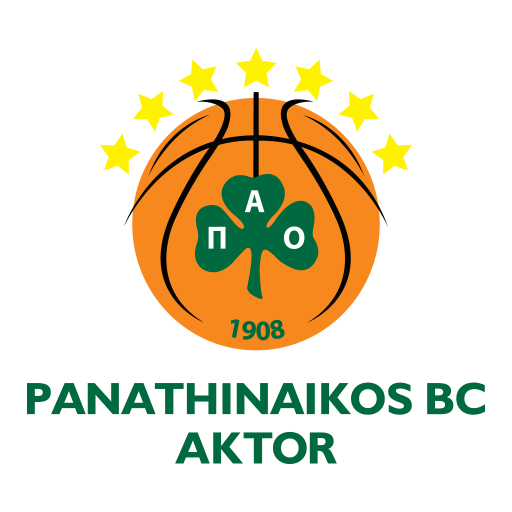
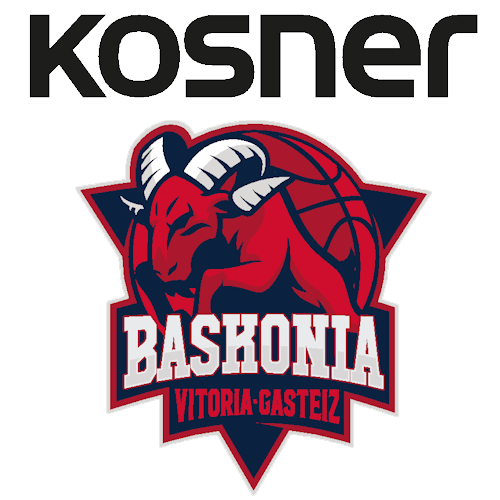
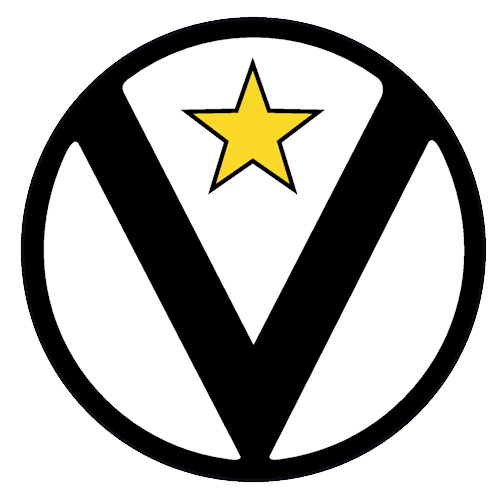
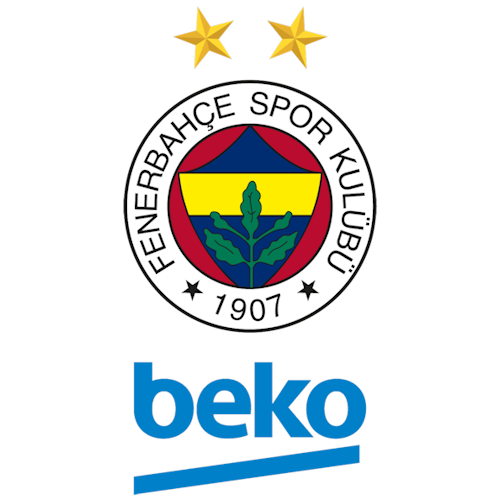
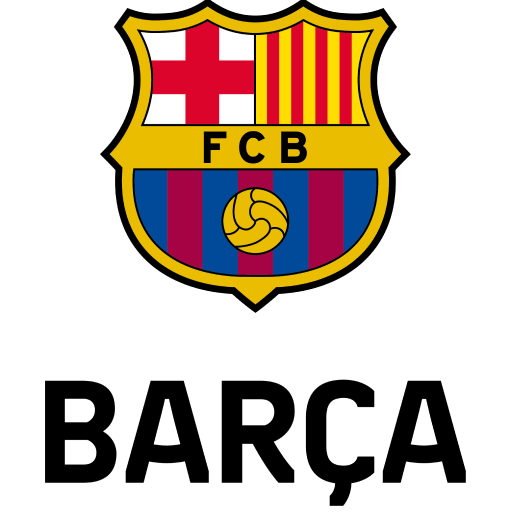
...
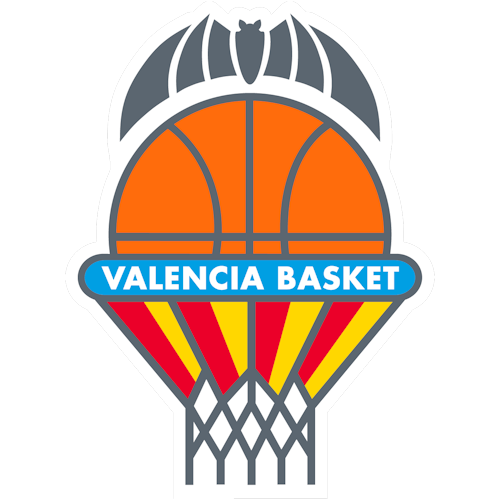
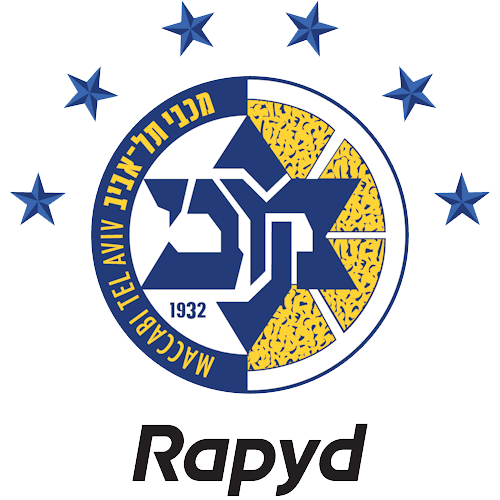
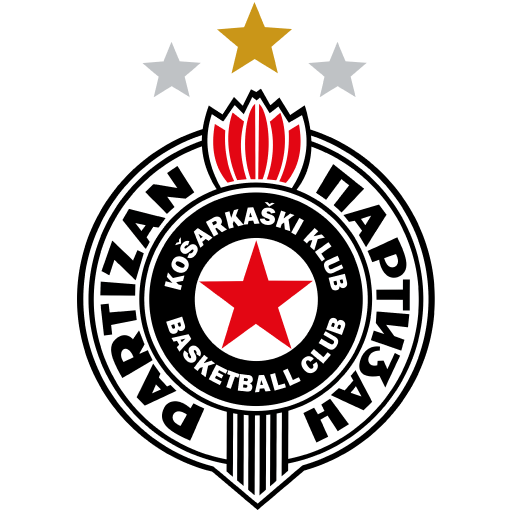
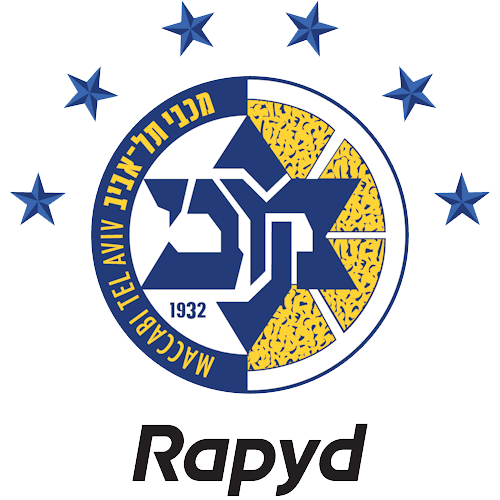
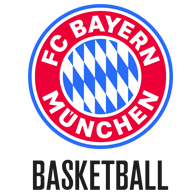

alt.HConcatChart(...)
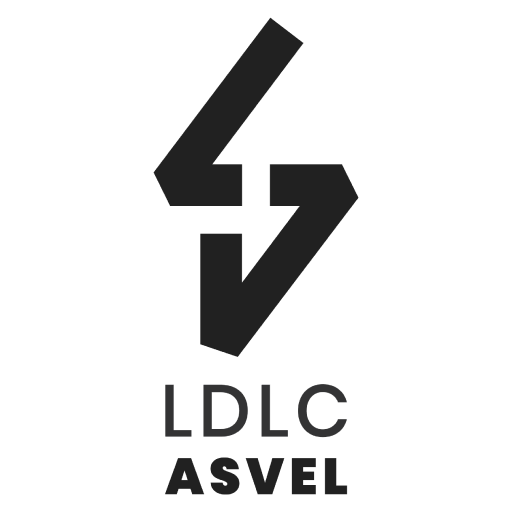
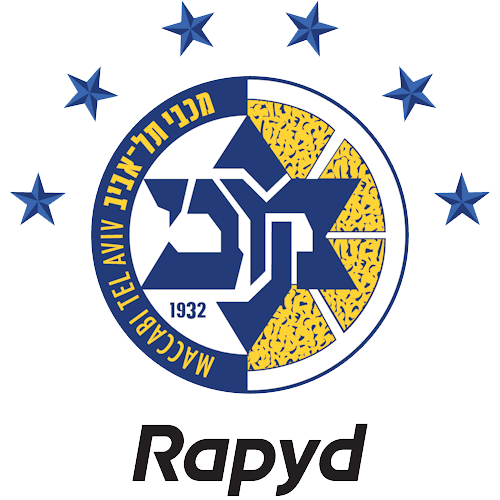
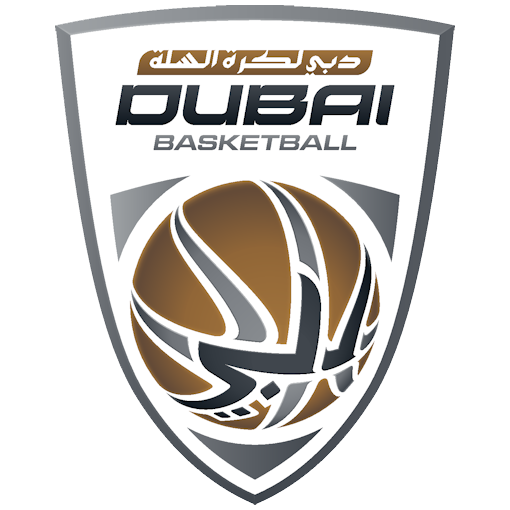
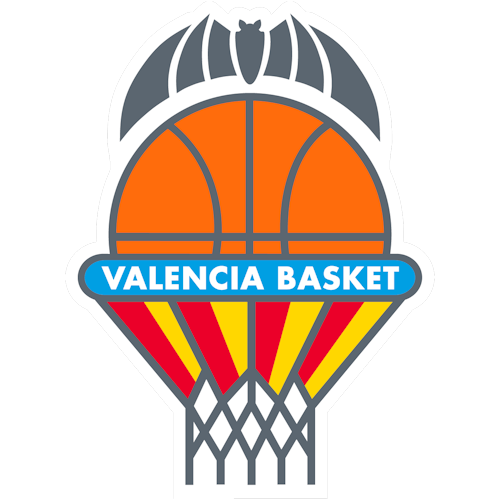
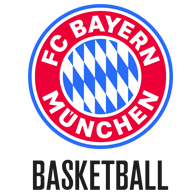
...
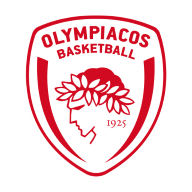
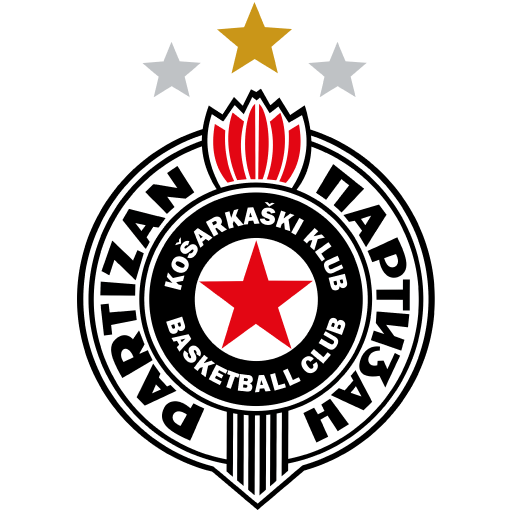
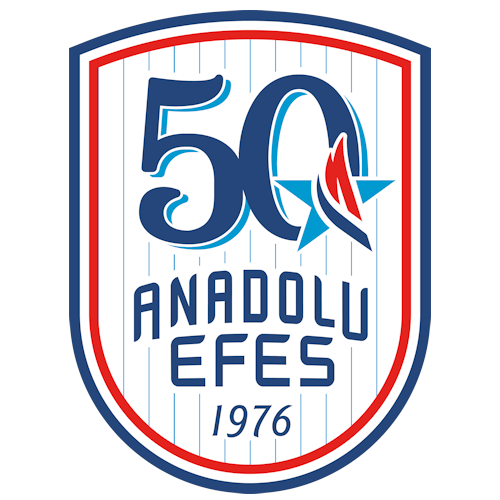
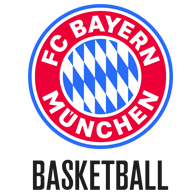
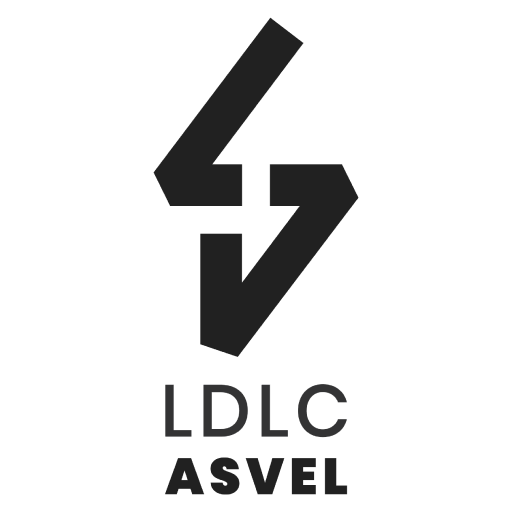

alt.HConcatChart(...)
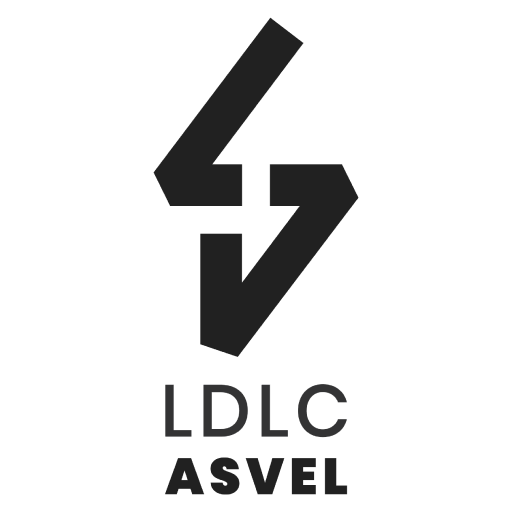
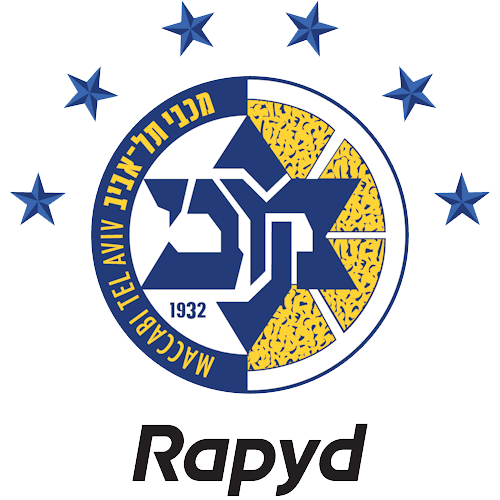
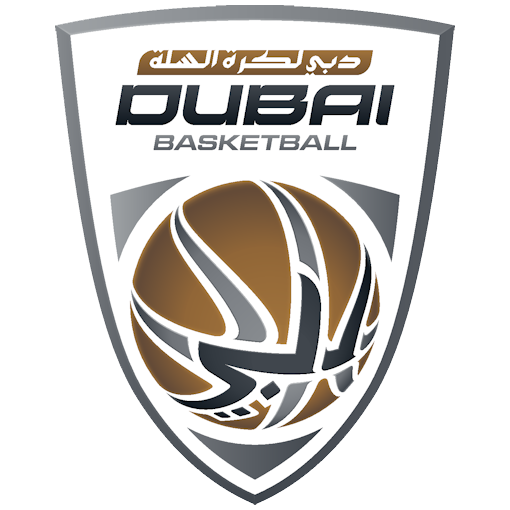
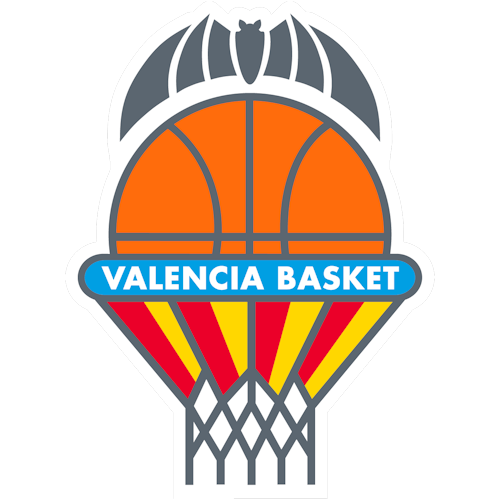
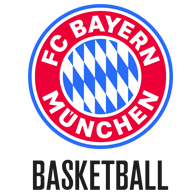
...
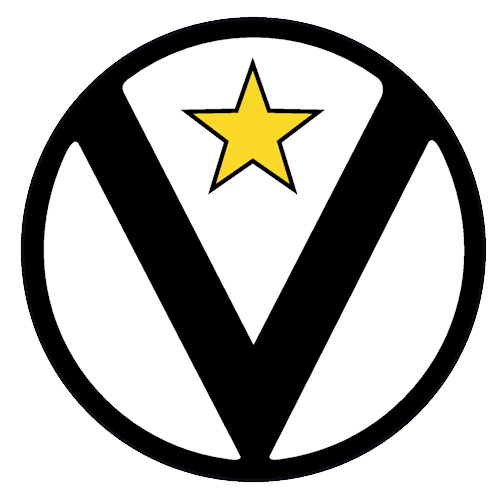
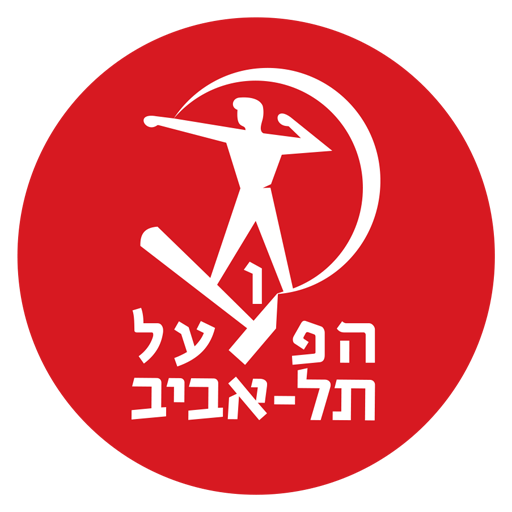
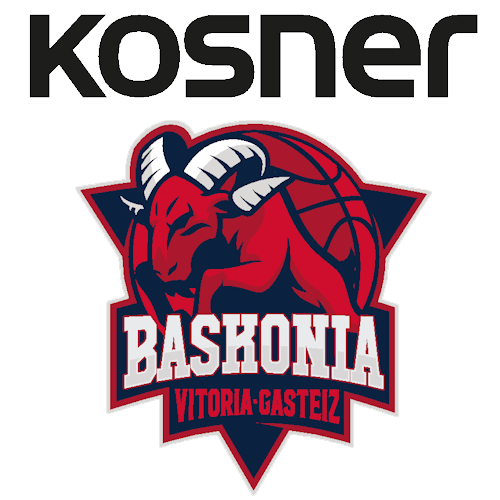
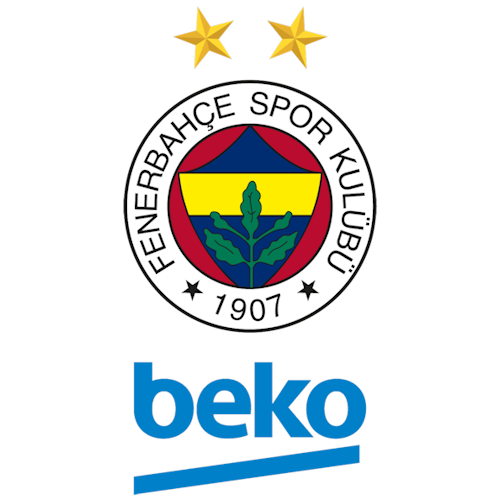
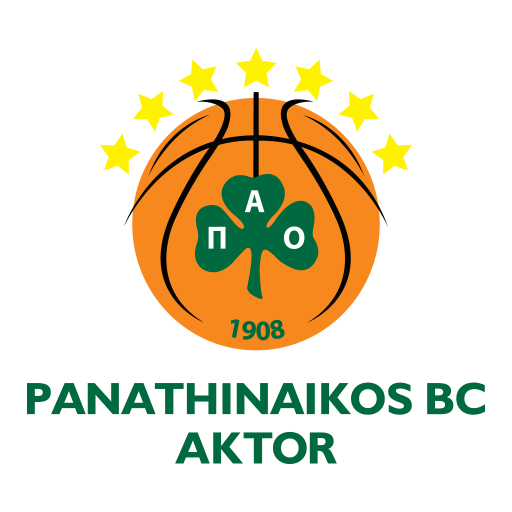

In [29]:
schedule_csv = "EL_2025_26_EL_RS_Schedule.csv"
season = 2025
CURRENT_ROUND = 15 # Use +1 of the last completed round
NEXTN = 5

games_meta, team_stats_api, metadata_api = load_games_metadata(season)

team_ratings, sos_net = compute_sos_from_netrtg_up_to_round(
    games_meta=games_meta,
    season=season,
    team_stats_api=team_stats_api,
    round_max=CURRENT_ROUND,
)

sos_win = compute_sos_from_winpct_up_to_round(
    games_meta=games_meta,
    round_max=CURRENT_ROUND,
)


# next-N SoS table & chart (already using CURRENT_ROUND in its own title)
sos_nextN_df = make_nextN_sos_table(
    current_round=CURRENT_ROUND,
    schedule_path=schedule_csv,
    games_meta=games_meta,
    team_ratings=team_ratings,
    team_to_logo_path_fn=team_to_logo_path,
    n_next=NEXTN,
)

nextN_chart = build_nextN_altair_logos_table(
    nextN_df=sos_nextN_df,
    team_ratings=team_ratings,
    team_to_logo_path_fn=team_to_logo_path,
    round_ref=CURRENT_ROUND,
    n_next=NEXTN,
)

# scatter: SoS(NetRtg) vs NetRtg
scatter_chart = make_sos_scatter_with_table(
    sos_net=sos_net,
    team_ratings=team_ratings,
    team_to_logo_path=team_to_logo_path,
    logo_to_dataurl=logo_to_dataurl,
    top_k=4,
    bottom_k=4,
    round_ref=CURRENT_ROUND,
    season_label="2025-26",
)

# SoS table
sos_table_chart = make_sos_table_chart(
    sos_net=sos_net,
    sos_win=sos_win,
    team_to_logo_path=team_to_logo_path,
    logo_to_dataurl=logo_to_dataurl,
    round_ref=CURRENT_ROUND,
    season_label="2025-26",
    logo_size=24,
    padding_inner=0.55,
)

display(nextN_chart)
display(scatter_chart)
display(sos_table_chart)